## < EDA : Location Distribution >

We would like to see where the geographical distribution of Air BNB rentals in NYC and find out where the popular locations are as well.

In [1]:
# Import packages

import numpy as np
import pandas as pd
%matplotlib inline
import matplotlib.pyplot as plt

In [3]:
# Load dataset

df = pd.read_csv("~/Desktop/AirBnbNYC2019.csv") 
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [4]:
# Identify variable types

def describe_data(df):
    print("Data Types:")
    print(df.dtypes)
    print("Rows and Columns:")
    print(df.shape)
    
describe_data(df)

Data Types:
id                                  int64
name                               object
host_id                             int64
host_name                          object
neighbourhood_group                object
neighbourhood                      object
latitude                          float64
longitude                         float64
room_type                          object
price                               int64
minimum_nights                      int64
number_of_reviews                   int64
last_review                        object
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
dtype: object
Rows and Columns:
(48895, 16)


In [5]:
# Identify column names for further analysis
 
list(df.columns)

['id',
 'name',
 'host_id',
 'host_name',
 'neighbourhood_group',
 'neighbourhood',
 'latitude',
 'longitude',
 'room_type',
 'price',
 'minimum_nights',
 'number_of_reviews',
 'last_review',
 'reviews_per_month',
 'calculated_host_listings_count',
 'availability_365']

In [6]:
# Identify unique borough names

df['neighbourhood_group'].unique()

array(['Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Bronx'],
      dtype=object)

In [7]:
# Create an interactive distribution map for AirBNB locations in NYC.

import pandas as pd
import folium

m1 = folium.Map(location=[40.693943, -73.985880], default_zoom_start=10, width=640, height=480)

for lat, lon, label in zip(df.latitude, df.longitude, df.neighbourhood.astype(str)):
    if label!='0':
        folium.features.CircleMarker(
            [lat, lon],
            radius=0.1,
            color='#0f4fff',
            color_opacity=0.6
        ).add_to(m1)

m1

In [8]:
# Check location frequencies for each boroughs

BoroCounts = df.neighbourhood_group.value_counts()
print("-------Frequency counts for BORO column-------\n",BoroCounts)
print(type(BoroCounts))

-------Frequency counts for BORO column-------
 Manhattan        21661
Brooklyn         20104
Queens            5666
Bronx             1091
Staten Island      373
Name: neighbourhood_group, dtype: int64
<class 'pandas.core.series.Series'>


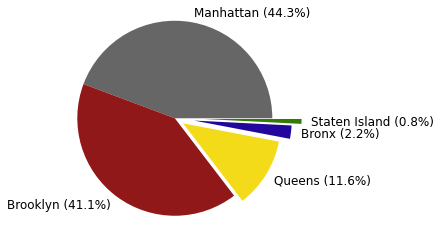

In [9]:
# Connstruct a pie chart for above summary

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl

counts = pd.Series([44.3, 41.1, 11.6, 2.2, 0.8], 
                   index=['Manhattan (44.3%)', 'Brooklyn (41.1%)', 'Queens (11.6%)', 
                          'Bronx (2.2%)', 'Staten Island (0.8%)'])

explode = (0,0,0.1,0.2,0.3)
colors = ['#666666', '#911818', '#f4db1a', '#23079c', '#347a06']

counts.plot(kind='pie', fontsize=12, colors=colors, explode=explode)
plt.axis('equal')
plt.ylabel('')
plt.show()

< Location destribution summary >
- Airbnb locations in NYC are mostly in Manhattan and Brooklyn: detailed distribution is below;
    1. Manhattan = 44.3% (21661 listings)
    2. Brooklyn = 41.1% (20104 listings)
    3. Queens = 11.6% (5666 listings)
    4. Bronx = 2.2% (1091 listings)
    5. Staten Island = 0.8% (373 listings)